In [1]:
import sys
from torch.utils.data import DataLoader

sys.path.append('../src')

from utils.data_loader import (
    CloudDataset,
    visualize_batch
)

from utils.augmentation import (
    get_albumentations_transform
)

In [2]:
images_dir = '../data/dados/images'
masks_dir = '../data/dados/masks'

dataset = CloudDataset(images_dir=images_dir, masks_dir=masks_dir)

# Cria um DataLoader para iterar sobre o dataset em batches
dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

# Exemplo de iteração sobre o dataloader:
for images, masks in dataloader:
    print("Shape das imagens: ", images.shape)  # [B, C, H, W]
    print("Shape das máscaras: ", masks.shape)  # [B, 1, H, W]
    break

Shape das imagens:  torch.Size([32, 3, 384, 384])
Shape das máscaras:  torch.Size([32, 1, 384, 384])


# Sem aumento

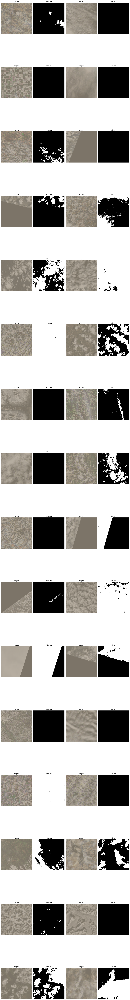

In [3]:
for images, masks in dataloader:
    # Visualiza o primeiro batch
    visualize_batch(images, masks, ncols=2)
    break

# Aumento de dados

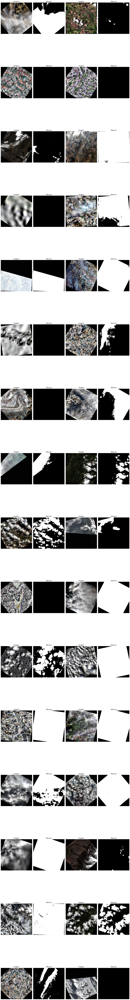

In [4]:
transform = get_albumentations_transform()
dataset = CloudDataset(images_dir='../data/dados/images', masks_dir='../data/dados/masks', transform=transform)

dataloader = DataLoader(dataset, batch_size=32, shuffle=True)
images, masks = next(iter(dataloader))

visualize_batch(images, masks, ncols=2)